## 1. Alternative: Read in .h5 files using the MCS Py Data Tools and Export Spiketimes 



"""
Created on Fri Jul 31 09:53:07 2020

@author: jonas ort, department of neurosurgery, RWTH AACHEN, medical faculty

ADJUSTMENTS:
    - define three directories, they should all exist BEFORE running this script
    - adjust pre and post cutouts
    - adjust high- and low-cut filters
    
DEPENDENCIES:
    - see imports
    - plot_signal_and_spikes.py
    - Butterworth_Filter.py

INPUT:
    - .h5 File of a MEA recording as generated by the MCS Data Manager, can be
      be arranged in one folder

OUTPUT:
    - spikes_STD_dict.npy = Dictionary of Spiketimes as detected by threshold
      crossing of -5* STD
    - spikes_MAD_dict.npy = Dictionary of Spiketimes as detected by threshold
      crossing of -5* MEDIAN ABSOLUTE DEVIATION
    - wavecutouts_dict.npy = Dictionary of all Wavecutouts for each channel
      of each slice
    - firingrate_dict.npy = Dictionary of the firingrate for each channel
    - For each channel with at least 1 Spike detected, a plot of the bandpass-
      filtered Signal, the threshold and the spikes will be created
    

NOTA BENE:
    - Cutting out waveforms takes up a lot of memory and increases the working
      time profoundly.
    - Most Outputs are set on inactive with #. Uncheck what you need.
    - Depending on the working system, the length of an array that can be passed
      towards the plotting function is limited. Recordings above 120 seconds 
      will run out of memory on a 64GB RAM machine, causing the script to stop.
    
    
ACKNOWLEDGEMENTS:
    - This script uses the code snippets of a Tutorial by MSC PyDataTools and
      were adjusted to the researchers needs.



OVERVIEW:
    1. Directories and Inputs
    2. Funcions
    3. Working Script



"""

In [2]:
"""
DIRECTORIES
"""

# adjust the directories first!
scriptdirectory = "C:/Users/User/Documents/JO/gitkraken/MEA_analysis/Tübingen_Branch"
inputdirectory = r"D:\MEA_DATA_Aachen\PREPROCESSED\20210510_cortex_div4"


In [3]:
"""
IMPORTS
"""


import os
os.chdir(scriptdirectory)

import sys
import numpy as np
import neo
import pandas as pd
import h5py
from hdfviewer.widgets.HDFViewer import HDFViewer
from hdfviewer.widgets.PathSelector import PathSelector
import McsPy
import sys, importlib, os
import McsPy.McsData
import McsPy.McsCMOS
from McsPy import ureg, Q_
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
from matplotlib.widgets import Slider
import bokeh.io
import bokeh.plotting
from bokeh.palettes import Spectral11
from scipy.signal import butter, lfilter, freqz, find_peaks, correlate
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
import os
import numpy as np
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import McsPy
import McsPy.McsData
from McsPy import ureg, Q_
import matplotlib.pyplot as plt

%matplotlib inline
import warnings

warnings.filterwarnings('ignore')

from Butterworth_Filter import butter_bandpass, butter_bandpass_filter
import glob
import scipy
import matplotlib.pyplot as plt
from plot_signal_and_spikes import plot_signal_and_spikes_from_bandpassfilteredsignal
import time
import glob



In [4]:

timestr = time.strftime("%d%m%Y")
outputdirectory="D:/MEA_DATA_Aachen/ANALYZED"


### Functions

In [5]:
'''
_____________________________FUNCTIONS____________________________________
'''

def get_channel_infos(filedirectory, meafile):
    channel_raw_data = McsPy.McsData.RawData(os.path.join(filedirectory, 
                                                          meafile))
    print(channel_raw_data.recordings)
    print(channel_raw_data.comment)
    print(channel_raw_data.date)
    print(channel_raw_data.clr_date)
    print(channel_raw_data.date_in_clr_ticks)
    print(channel_raw_data.file_guid)
    print(channel_raw_data.mea_name)
    print(channel_raw_data.mea_sn)
    print(channel_raw_data.mea_layout)
    print(channel_raw_data.program_name)
    print(channel_raw_data.program_version)
    analognumber = len(channel_raw_data.recordings[0].analog_streams.keys())
    print('In total '+ str(analognumber) 
          + " analog_streams were identified.\n")
    for i in range(len(channel_raw_data.recordings[0].analog_streams.keys())):
        keylist = []
        stream = channel_raw_data.recordings[0].analog_streams[i]
        for key in stream.channel_infos.keys():
                keylist.append(key)
        channel_id = keylist[0]
        datapoints = channel_raw_data.recordings[0].analog_streams[i].channel_data.shape[1]
        samplingfrequency = stream.channel_infos[channel_id].sampling_frequency
        ticks = stream.channel_infos[channel_id].info['Tick']
        time = stream.get_channel_sample_timestamps(channel_id)
        scale_factor_for_second = Q_(1,time[1]).to(ureg.s).magnitude
        time_in_sec = time[0] * scale_factor_for_second
        timelengthrecording_ms = time[0][-1]+ticks
        timelengthrecording_s = (time[0][-1]+ticks)*scale_factor_for_second
        print("analog_stream Nr. " + str(i) + ": ")
        print("datapoints measured = " + str(datapoints))
        print("sampling frequency = " + str(samplingfrequency))
        print("ticks = " + str(ticks))
        print("total recordingtime is: " 
              + str(timelengthrecording_s) + "seconds \n")




def get_MEA_Signal(analog_stream, channel_idx, from_in_s=0, to_in_s=None):
    '''
    Extracts one Channels (channel_idx) Sginal 
    
    :param analog_stream = the analogstream from one recording
    :param channel_idx   = the channel index of the channel where you 
                            extract the values from
    :param from_in_s     = starting point of the range you want to observe 
                            in seconds
    :param to_in_s       = ending point of the range you want to observe. 
                            Default is None (i.e. whole range)
    
    Returns: the signal in uV, time stamps in sec, the sampling frequency
    
    
    '''
    ids = [c.channel_id for c in analog_stream.channel_infos.values()]
    channel_id = ids[channel_idx]
    channel_info = analog_stream.channel_infos[channel_id]
    sampling_frequency = channel_info.sampling_frequency.magnitude

    # get start and end index
    from_idx = max(0, int(from_in_s * sampling_frequency))
    if to_in_s is None:
        to_idx = analog_stream.channel_data.shape[1]
    else:
        to_idx = min(
            analog_stream.channel_data.shape[1], 
            int(to_in_s * sampling_frequency)
            )

    # get the timestamps for each sample
    time = analog_stream.get_channel_sample_timestamps(
        channel_id, from_idx, to_idx
        )

    # scale time to seconds:
    scale_factor_for_second = Q_(1,time[1]).to(ureg.s).magnitude
    time_in_sec = time[0] * scale_factor_for_second

    # get the signal
    signal = analog_stream.get_channel_in_range(channel_id, from_idx, to_idx)

    # scale signal to µV:
    scale_factor_for_uV = Q_(1,signal[1]).to(ureg.uV).magnitude
    signal_in_uV = signal[0] * scale_factor_for_uV
    
    return signal_in_uV, time_in_sec, sampling_frequency, scale_factor_for_second


def get_MEA_Channel_labels(np_analog_for_filter):
    '''
    Gives a List of all MEA Channel Labels (e.g. R12) in the order they appear
    within the recording.
    
    :param analogstream_data = an numpy array shape(channels, data)
    
    '''
    labellist = []
    for i in range(0, len(np_analog_for_filter)):
        #channel_idx = i
        ids = [c.channel_id for c in analog_stream_0.channel_infos.values()]
        channel_id = ids[i]
        channel_info = analog_stream_0.channel_infos[channel_id]
        #print(channel_info.info['Label'])
        labellist.append(channel_info.info['Label'])
    return labellist
    

def detect_threshold_crossings(signal, fs, threshold, dead_time):
    """
    Detect threshold crossings in a signal with dead time and return 
    them as an array

    The signal transitions from a sample above the threshold to a sample 
    below the threshold for a detection and
    the last detection has to be more than dead_time apart 
    from the current one.

    :param signal: The signal as a 1-dimensional numpy array
    :param fs: The sampling frequency in Hz
    :param threshold: The threshold for the signal
    :param dead_time: The dead time in seconds.
    """
    dead_time_idx = dead_time * fs
    threshold_crossings = np.diff(
        (signal <= threshold).astype(int) > 0).nonzero()[0]
    distance_sufficient = np.insert(
        np.diff(threshold_crossings) >= dead_time_idx, 0, True
        )
    while not np.all(distance_sufficient):
        # repeatedly remove all threshold crossings that violate the dead_time
        threshold_crossings = threshold_crossings[distance_sufficient]
        distance_sufficient = np.insert(
            np.diff(threshold_crossings) >= dead_time_idx, 0, True
            )
    return threshold_crossings


def get_next_minimum(signal, index, max_samples_to_search):
    """
    Returns the index of the next minimum in the signal after an index

    :param signal: The signal as a 1-dimensional numpy array
    :param index: The scalar index
    :param max_samples_to_search: The number of samples to search for a 
                                    minimum after the index
    """
    search_end_idx = min(index + max_samples_to_search, signal.shape[0])
    min_idx = np.argmin(signal[index:search_end_idx])
    return index + min_idx


def align_to_minimum(signal, fs, threshold_crossings, search_range, first_time_stamp=0):
    """
    Returns the index of the next negative spike peak for all threshold crossings

    :param signal: The signal as a 1-dimensional numpy array
    :param fs: The sampling frequency in Hz
    :param threshold_crossings: The array of indices where the signal 
                                crossed the detection threshold
    :param search_range: The maximum duration in seconds to search for the 
                         minimum after each crossing
    """
    search_end = int(search_range*fs)
    aligned_spikes = [get_next_minimum(signal, t, search_end) for t in threshold_crossings]
    return np.array(aligned_spikes)


def find_triggers(dset_trigger, tick):
    
    for i in range(0,len(dset_trigger)-1):
        trigger_n=i
        Trigger_An=dset_trigger[trigger_n]
        diff_An=np.diff(Trigger_An)
        peaks, _ = find_peaks(diff_An, height = 2000) #MEA60=0.75
        peaks_off, _ = find_peaks(-diff_An, height = 2000) #""
        if len(peaks)>=0:
            break
    
    if trigger_n ==0:
        odd_peaks= peaks
        odd_peaks_off= peaks_off
    else:
        odd_peaks=peaks
        odd_peaks_off=peaks_off
    #x=np.arange(len(Trigger_An))*tick
    #plt.plot(x, Trigger_An)
    return odd_peaks, odd_peaks_off, diff_An

def spike_on_off(trigger_on, trigger_off, spikedic, tick):
    """
    Takes the dictionary with all spikes and sorts them into either a dictionary for
    spikes while trigger on (=ONdic) or off (=OFFdic)
    
    :param trigger_on =basically created through the find_triggers function 
                        and marks points were stimulation is turned on
    :param trigger_off =see trigger_on but for stimulation off
    :spikedic = dictionary of spikes for each electrode
    :tick
    """
    on=[]
    off=[]
    ONdic ={}
    OFFdic={}
    Trigger_An=[]
    Trigger_Aus=[]
    
    if len(trigger_off)==0:
        Trigger_An=[]
    elif trigger_off[len(trigger_off)-1]>trigger_on[len(trigger_on)-1]:
        Trigger_An=trigger_on*tick
    else:
        Trigger_An=[]
        for n in range(0,len(trigger_on)-1):
            Trigger_An.append(trigger_on[n]*tick)   
        Trigger_An=np.array(Trigger_An)

            
    if len(trigger_on)==0:
        Trigger_Aus=[]
    elif trigger_off[0]>trigger_on[0]:
        Trigger_Aus=trigger_off*tick
    else:
        Trigger_Aus=[]
        for n in range(1,len(trigger_off)):
            Trigger_Aus.append(trigger_off[n]*tick)
        Trigger_Aus=np.array(Trigger_Aus)
    
    Trigger_Aus2=np.insert(Trigger_Aus,0,0)
    
    for key in spikedic:
        ON = []
        OFF = []
        for i in spikedic[key]: #i mit 40 multiplizieren, da Trigger an und aus mit Tick multipliziert sind
            if len(Trigger_An)==0:
                OFF.append(i)
            if any(Trigger_An[foo] < i*tick < Trigger_Aus[foo]  for foo in np.arange(len(Trigger_Aus)-1)):
                ON.append(i)
            elif any(Trigger_Aus2[foo]  < i*tick < Trigger_An[foo]  for foo in np.arange(len(Trigger_An))):
                OFF.append(i)
        ONdic[key]=np.asarray(ON)
        OFFdic[key]=np.asarray(OFF)
    
    return ONdic, OFFdic


def extract_waveforms(signal, fs, spikes_idx, pre, post):
    """
    Extract spike waveforms as signal cutouts around each spike index as a spikes x samples numpy array

    :param signal: The signal as a 1-dimensional numpy array
    :param fs: The sampling frequency in Hz
    :param spikes_idx: The sample index of all spikes as a 1-dim numpy array
    :param pre: The duration of the cutout before the spike in seconds
    :param post: The duration of the cutout after the spike in seconds
    """
    cutouts = []
    pre_idx = int(pre * fs)
    post_idx = int(post * fs)
    for index in spikes_idx:
        if index-pre_idx >= 0 and index+post_idx <= signal.shape[0]:
            cutout = signal[int((index-pre_idx)):int((index+post_idx))]
            cutouts.append(cutout)
    if len(cutouts)>0:
        return np.stack(cutouts)
    
    
def plot_waveforms(cutouts, fs, pre, post, n=100, color='k', show=True):
    """
    Plot an overlay of spike cutouts

    :param cutouts: A spikes x samples array of cutouts
    :param fs: The sampling frequency in Hz
    :param pre: The duration of the cutout before the spike in seconds
    :param post: The duration of the cutout after the spike in seconds
    :param n: The number of cutouts to plot, or None to plot all. Default: 100
    :param color: The line color as a pyplot line/marker style. Default: 'k'=black
    :param show: Set this to False to disable showing the plot. Default: True
    """
    if n is None:
        n = cutouts.shape[0]
    n = min(n, cutouts.shape[0])
    time_in_us = np.arange(-pre*1000, post*1000, 1e3/fs)
    if show:
        _ = plt.figure(figsize=(12,6))

    for i in range(n):
        _ = plt.plot(time_in_us, cutouts[i,]*1e6, color, linewidth=1, alpha=0.3)
        _ = plt.xlabel('Time (%s)' % ureg.ms)
        _ = plt.ylabel('Voltage (%s)' % ureg.uV)
        _ = plt.title('Cutouts')

    if show:
        plt.show()


'\n_____________________________FUNCTIONS____________________________________\n'

#### Adjust filters

In [6]:
# set filter cuts in Hz
lowcut = 150
highcut = 4500

# Length of cutouts around shapes
pre = 0.001 # 1 ms
post= 0.002 # 2 ms


In [7]:
# get filelist
os.chdir(inputdirectory)
filelist= glob.glob("*.h5")

In [8]:
# see all files in the filelist
filelist

['2021-05-10T13-50-07__cortex_div4_hCSF_ID039_nodrug_spont_1__.h5',
 '2021-05-10T14-05-26__cortex_div4_hCSF_ID039_30µMCNQX_spont_1__.h5']

In [9]:
resting_spikedic={}
spikedic={}
spikedic_MAD={}
artefactsdic_MAD={}
cutouts_dic ={} 
keylist = []

In [10]:
# choose file to continue analysis on:
file = filelist[0]

In [11]:
resting_spikedic={}
spikedic={}
cutouts_dic ={} 
keylist = []
filename = file
filedatebase = filename.split('T')[0]
filenamebase = filename.split('__')[1]
filebase = filedatebase + '_' + filenamebase
print('Working on file: ' +filename)
channel_raw_data = McsPy.McsData.RawData(filename)
get_channel_infos(inputdirectory, filename)

Working on file: 2021-05-10T13-50-07__cortex_div4_hCSF_ID039_nodrug_spont_1__.h5
Recording_0 <HDF5 group "/Data/Recording_0" (2 members)>
{0: <Recording label=, AnalogStreams=3, EventStreams=1, duration_time=130400000 microsecond>}

2021-05-10 13:50:07.705248
Montag, 10. Mai 2021
637562514077052461
96de149f-d9c2-4684-8c83-dd3bc3407692
256MEA

MEA_256MEA_MEA2100_252_6
Multi Channel Experimenter
2.15.0.20098
Stream_0 <HDF5 group "/Data/Recording_0/AnalogStream/Stream_0" (3 members)>
ChannelData <HDF5 dataset "ChannelData": shape (252, 3260000), type "<i4">
ChannelDataTimeStamps <HDF5 dataset "ChannelDataTimeStamps": shape (1, 3), type "<i8">
InfoChannel <HDF5 dataset "InfoChannel": shape (252,), type "|V108">
Stream_1 <HDF5 group "/Data/Recording_0/AnalogStream/Stream_1" (3 members)>
ChannelData <HDF5 dataset "ChannelData": shape (1, 3260000), type "<i4">
ChannelDataTimeStamps <HDF5 dataset "ChannelDataTimeStamps": shape (1, 3), type "<i8">
InfoChannel <HDF5 dataset "InfoChannel": shape 

In [12]:



analog_stream_0 = channel_raw_data.recordings[0].analog_streams[0]
stream = analog_stream_0
for key in stream.channel_infos.keys():
    keylist.append(key)
    
channel_id = keylist[0]
tick = stream.channel_infos[channel_id].info['Tick']
time = stream.get_channel_sample_timestamps(channel_id)
first_recording_timepoint = time[0][0]
scale_factor_for_second = Q_(1,time[1]).to(ureg.s).magnitude
time_in_sec = time[0]*scale_factor_for_second
timelengthrecording_ms = time[0][-1]+tick
timelengthrecording_s = (time[0][-1]+tick)*scale_factor_for_second
fs = int(stream.channel_infos[channel_id].sampling_frequency.magnitude)

analog_stream_0_data = analog_stream_0.channel_data
np_analog_stream_0_data = np.transpose(
    channel_raw_data.recordings[0].analog_streams[0].channel_data
    )

# the stream needs to be changed because MCS hates me
np_analog_for_filter = np.transpose(np_analog_stream_0_data)
np_analog_stream_1_data = np.transpose(
    channel_raw_data.recordings[0].analog_streams[0].channel_data
    )
np_analog_stream_1_data_transpose = np.transpose(np_analog_stream_1_data)




Recording_0 <HDF5 group "/Data/Recording_0" (2 members)>
Stream_0 <HDF5 group "/Data/Recording_0/AnalogStream/Stream_0" (3 members)>
ChannelData <HDF5 dataset "ChannelData": shape (252, 3260000), type "<i4">
ChannelDataTimeStamps <HDF5 dataset "ChannelDataTimeStamps": shape (1, 3), type "<i8">
InfoChannel <HDF5 dataset "InfoChannel": shape (252,), type "|V108">
Stream_1 <HDF5 group "/Data/Recording_0/AnalogStream/Stream_1" (3 members)>
ChannelData <HDF5 dataset "ChannelData": shape (1, 3260000), type "<i4">
ChannelDataTimeStamps <HDF5 dataset "ChannelDataTimeStamps": shape (1, 3), type "<i8">
InfoChannel <HDF5 dataset "InfoChannel": shape (1,), type "|V108">
Stream_2 <HDF5 group "/Data/Recording_0/AnalogStream/Stream_2" (3 members)>
ChannelData <HDF5 dataset "ChannelData": shape (1, 3260000), type "<i4">
ChannelDataTimeStamps <HDF5 dataset "ChannelDataTimeStamps": shape (1, 3), type "<i8">
InfoChannel <HDF5 dataset "InfoChannel": shape (1,), type "|V108">


In [13]:

#timestr = time.strftime("%d%m%Y")
outpath = os.path.join(
    outputdirectory, filebase + '_analyzed_on_'+timestr
    ).replace("\\","/")
try:
    os.mkdir(outpath)
except OSError:
    print ("Creation of the directory %s failed" % outpath)
else:
    print ("Successfully created the directory %s " % outpath)
    
os.chdir(outpath)


Creation of the directory D:/MEA_DATA_Aachen/ANALYZED/2021-05-10_cortex_div4_hCSF_ID039_nodrug_spont_1_analyzed_on_23072021 failed


In [14]:
time[0][0]

0

G13
G12
F16
F15
F14
F13
F12
E16
E15
E14
E13
G11
D16
D15
D14
H9
F11
C16
C15
D13
B16
B15
C14
A15
A14
B14
G10
E12
B13
C13
F10
A13
C12
D12
A12
B12
D11
E11
B11
C11
E10
A11
C10
D10
A10
B10
D9
E9
B9
C9
F9
A9
G8
G9
A8
F8
C8
B8
E8
D8
B7
A7
D7
C7
A6
E7
C6
B6
E6
D6
B5
A5
D5
C5
A4
F7
C4
B4
F6
H8
B3
A3
D4
A2
B2
B1
C3
C2
C1
E5
G7
D3
D2
D1
G6
E4
E3
E2
E1
F5
F4
F3
F2
F1
G5
G4
G3
G2
G1
H5
H4
H3
H2
H1
H6
H7
J7
J6
J1
J2
J3
J4
J5
K1
K2
K3
K4
K5
L1
L2
L3
L4
L5
M1
M2
M3
M4
K6
N1
N2
N3
J8
L6
O1
O2
N4
P1
P2
O3
R2
R3
P3
K7
M5
P4
O4
L7
R4
O5
N5
R5
P5
N6
M6
P6
O6
M7
R6
O7
N7
R7
P7
N8
M8
P8
O8
L8
R8
K9
K8
R9
L9
O9
P9
M9
N9
P10
R10
N10
O10
R11
M10
O11
P11
M11
N11
P12
R12
N12
O12
R13
L10
O13
P13
L11
J9
P14
R14
N13
R15
P16
P15
O15
O14
M12
O16
N14
K10
N16
N15
M13
K11
M15
M14
L12
M16
L14
L13
L16
L15
K13
K12
K15
K14
J12
K16
J14
J13
J16
J15
J10
J11
H11
H10
H15
H16
H13
H14
G16
H12
G14
G15


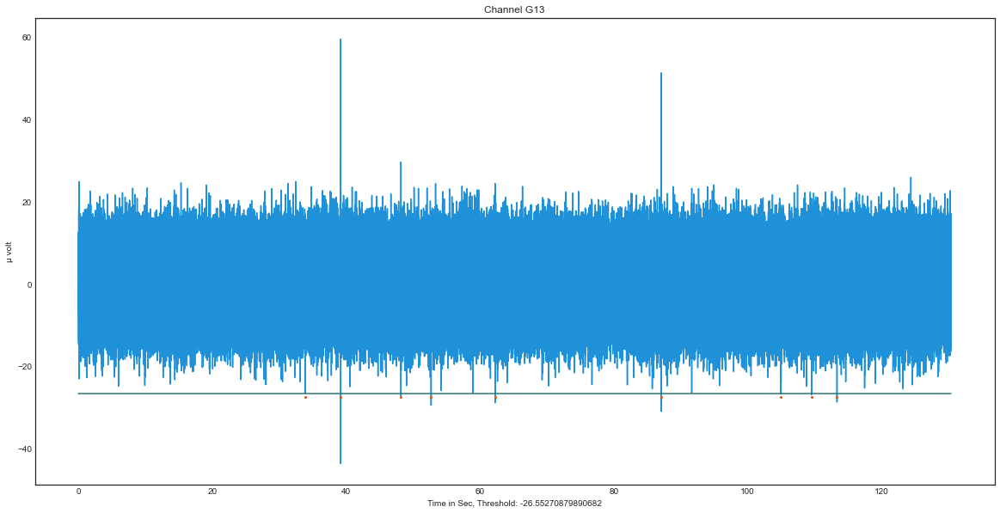

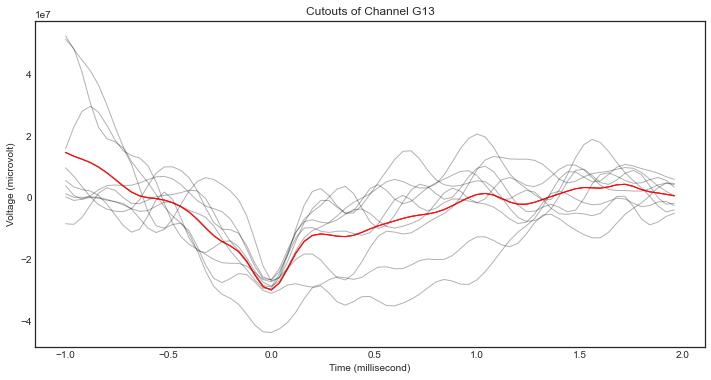

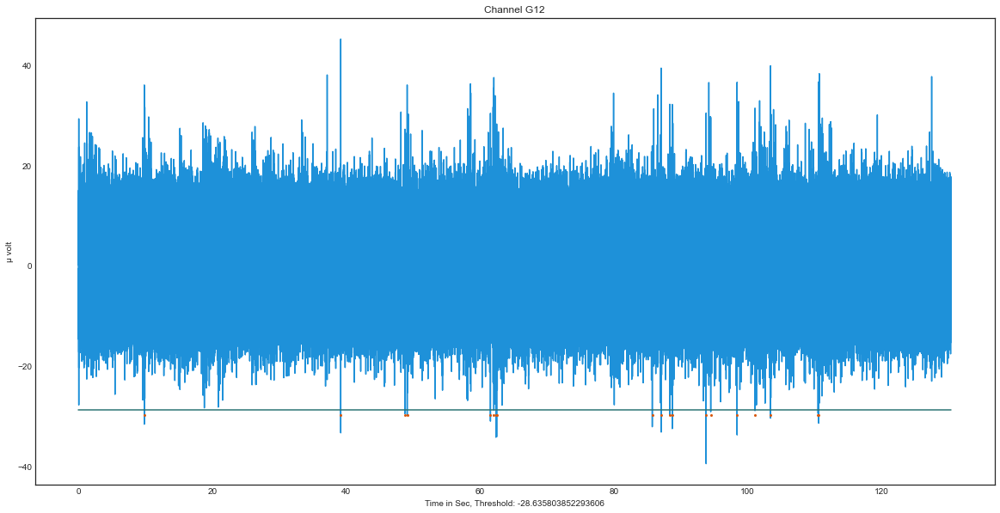

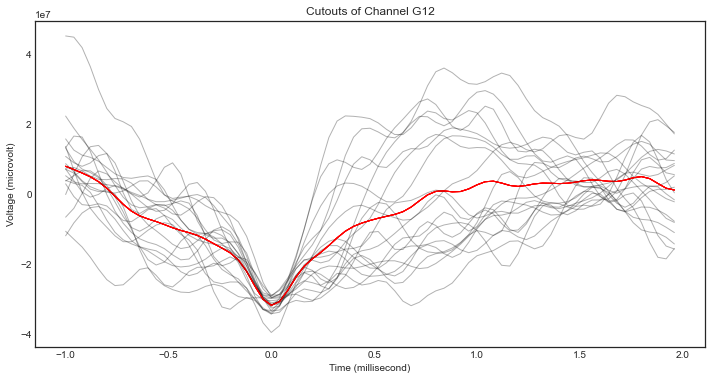

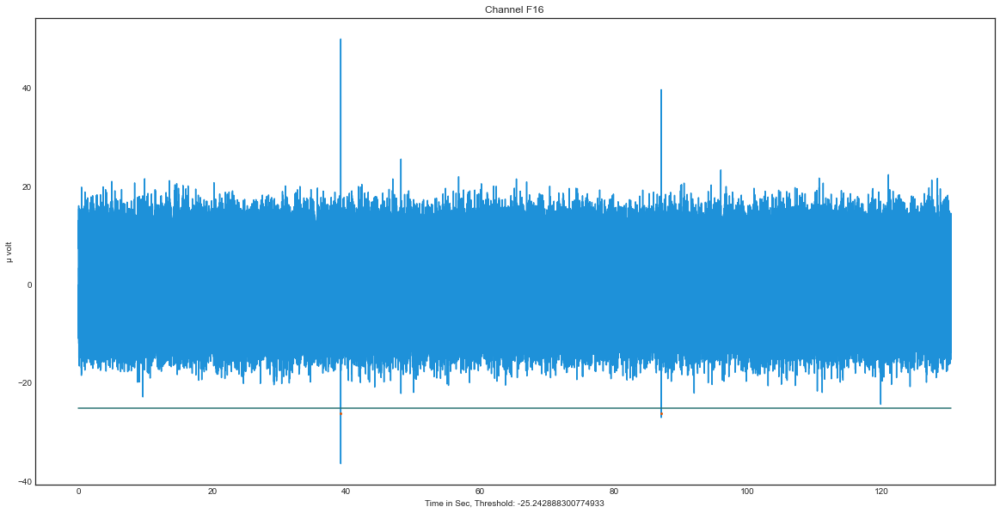

...

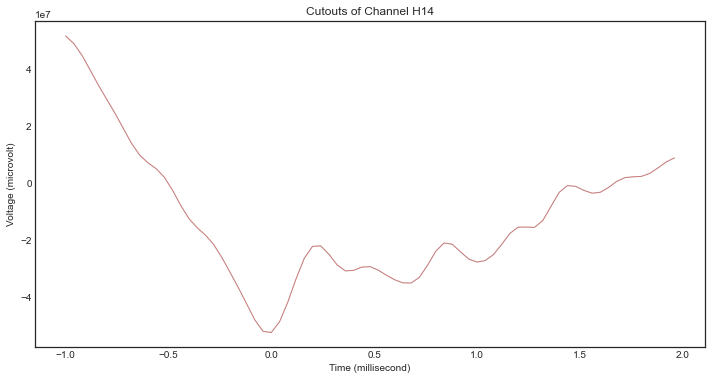

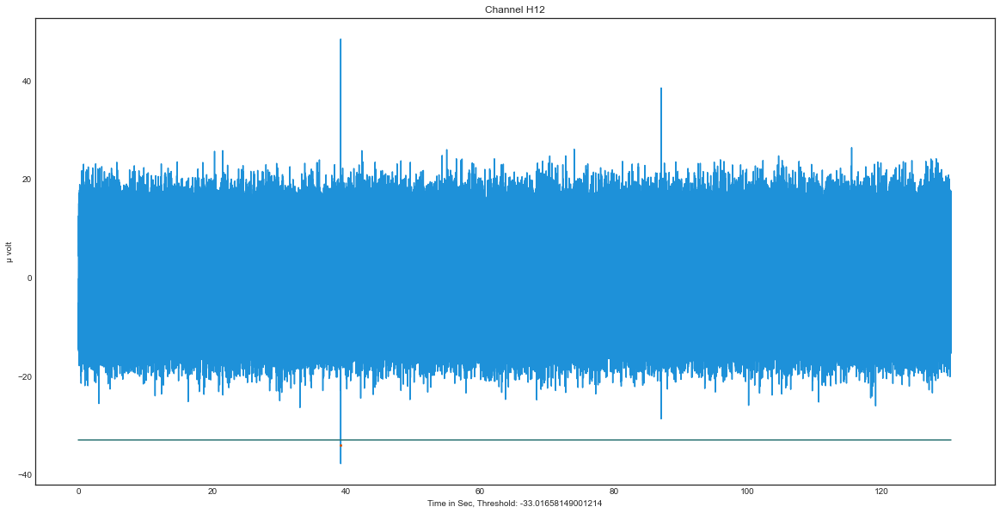

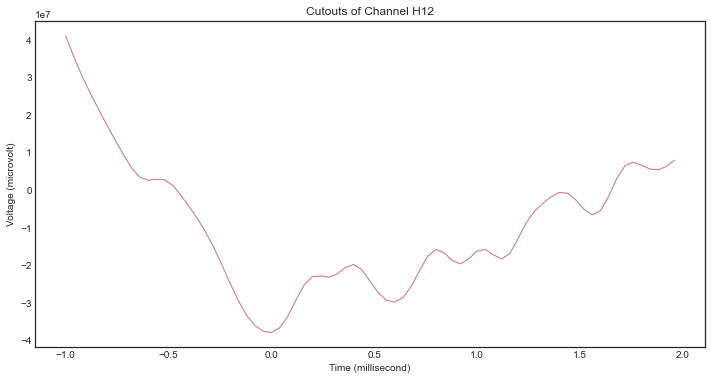

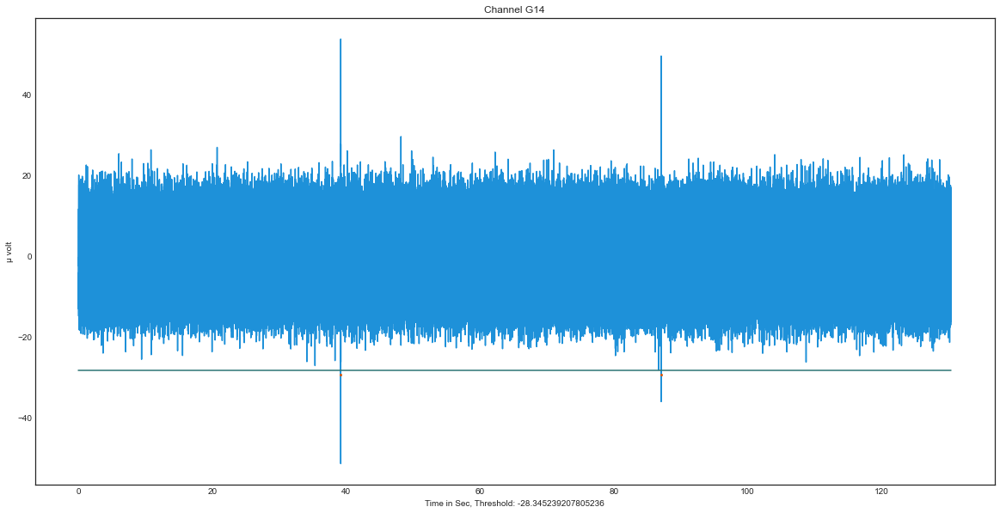

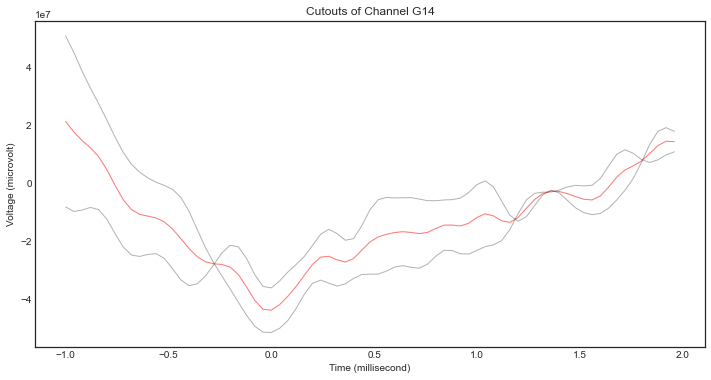

In [15]:
#for i in range (0, 10):
for i in range (0, len(np_analog_for_filter)):
    # for every channel we get the signal, filter it, define a threshold
    # see the crossings, align them to the next minimum (=spikes)
    # fill the dictionary with the tickpoints
    # and finally plot everything
    channel_idx = i
    labellist = get_MEA_Channel_labels(np_analog_for_filter)
    signal_in_uV, time_in_sec, sampling_frequency, scale_factor_for_second = get_MEA_Signal(analog_stream_0, channel_idx)
    bandpassfilteredsignal = butter_bandpass_filter(
        signal_in_uV, lowcut, highcut, sampling_frequency
        )

    # This Part is for finding MAD spikes + plotting
    noise_mad = np.median(np.absolute(bandpassfilteredsignal)) / 0.6745
    threshold = -5* noise_mad
    artefact_threshold = -8* noise_mad
    crossings = detect_threshold_crossings(
        bandpassfilteredsignal, sampling_frequency, 
        threshold, dead_time=0.003
        )
    spikes=align_to_minimum(
        bandpassfilteredsignal, fs, crossings, search_range=0.003, 
        first_time_stamp=first_recording_timepoint
        )
    
    if len(spikes) < 10:
        artefact_crossings = detect_threshold_crossings(
            bandpassfilteredsignal, sampling_frequency, 
            artefact_threshold, dead_time=0.003
            )
        artefacts = align_to_minimum(
            bandpassfilteredsignal, fs, artefact_crossings, search_range=0.003, 
            first_time_stamp=first_recording_timepoint
            )
    
    spikes = spikes + first_recording_timepoint/tick
    channellabel = labellist[i]
    spikedic_MAD[channellabel] = spikes
    artefactsdic_MAD[channellabel] = artefacts
    print(channellabel)
    
    
    # if there are detected spikes get the waveforms, plot the channel and waveforms and save
    if len(spikes > 0):
        cutouts = extract_waveforms(
                bandpassfilteredsignal, sampling_frequency, spikes, 
                pre, post
                )
        cutouts_dic[channellabel] = cutouts
        
        
        plt.style.use("seaborn-white")
        
        
        # figure 1: signal with threshold
        fig, ax = plt.subplots(1, 1, figsize=(20, 10))
        ax = plt.plot(time_in_sec, bandpassfilteredsignal, c="#1E91D9")
        ax = plt.plot([time_in_sec[0], time_in_sec[-1]], [threshold, threshold], c="#297373")
        ax = plt.plot(spikes*tick*scale_factor_for_second, [threshold-1]*(spikes*tick*scale_factor_for_second).shape[0], 'ro', ms=2, c="#D9580D")
        ax = plt.title('Channel %s' %channellabel)
        ax = plt.xlabel('Time in Sec, Threshold: %s' %threshold)
        ax = plt.ylabel('µ volt')
        
        fig.savefig(filebase+'_signal_'+channellabel+'MAD_THRESHOLD_artefact.png')
                               
        #figure 2: waveforms 
        fig2, ax2 = plt.subplots(1, 1, figsize=(12,6))
        #ax2 is a plot of the waveform cutouts
        n = 100
        n = min(n, cutouts.shape[0])
        time_in_us = np.arange(-pre*1000, post*1000, 1e3/fs)
        cutout_mean = np.mean(cutouts, axis=0)
        for i in range(n):
            ax2 = plt.plot(time_in_us, cutouts[i,]*1e6, color='black', linewidth=1, alpha=0.3)
            ax2 = plt.plot(time_in_us, cutout_mean*1e6, color="red", linewidth=1, alpha=0.3)
            ax2 = plt.xlabel('Time (%s)' % ureg.ms)
            ax2 = plt.ylabel('Voltage (%s)' % ureg.uV)
            ax2 = plt.title('Cutouts of Channel %s' %channellabel)

        fig2.savefig(filebase+'_waveforms_'+channellabel+'_.png')
        
        
        #ax2 = plot_waveforms(cutouts_dic[channellabel], fs, pre, post, n=250)
    

        
    

            
        
#     waves = plot_waveforms(cutouts_dic['G13'], fs, pre, post, n=250)
#     waves.savefig((filename+'_signal_'+channellabel+'_Waveforms.png'))

### Get a Rasterplot and Smoothed Activity Plot of the Whole Slice

- This needs to be implemented in the basics Script

In [16]:
# create an array of the spikes in scale of seconds

spikedic_seconds = {}
for key in spikedic_MAD:
    relevant_factor = timelengthrecording_s*0.5
    if len(spikedic_MAD[key])>relevant_factor:
        sec_array = spikedic_MAD[key]*tick*scale_factor_for_second
        spikedic_seconds[key]=sec_array
spikearray_seconds = np.asarray(list(spikedic_seconds.values()))

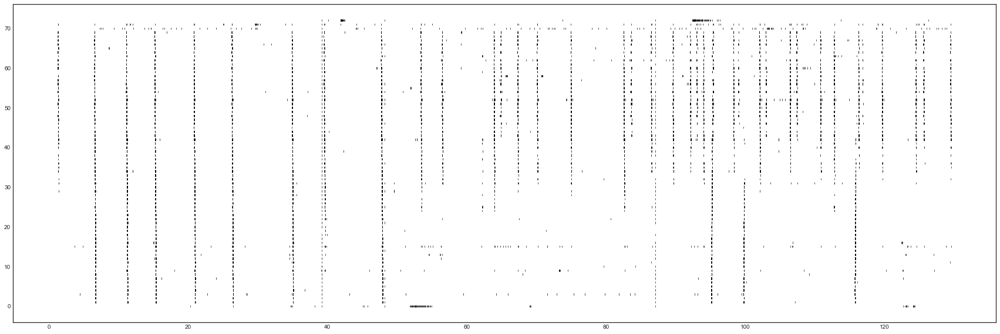

In [18]:
fig, ax = plt.subplots(1,1, figsize=(30,10))

ax = plt.eventplot(spikearray_seconds, linewidths=0.7, linelengths=0.5, colors='black')

fig.savefig(str(filebase)+'_rasterplot.png', dpi=300)

In [19]:
# get a 1-D array with every detected spike
scale_factor_for_milisecond = 1e-03
full_spike_list = []
full_spike_list_seconds = []
for key in spikedic_MAD:
    if len(spikedic_MAD[key])>relevant_factor:
        x = list(np.asarray(spikedic_MAD[key])*scale_factor_for_milisecond*tick)
        full_spike_list = full_spike_list + x

        xs = list(np.asarray(spikedic_MAD[key])*scale_factor_for_second*tick)
        full_spike_list_seconds = full_spike_list_seconds + xs
full_spikes = sorted(full_spike_list)
full_spikes_seconds = sorted(full_spike_list_seconds)


    

In [26]:
binsize = 0.005 #seconds
bins= np.arange(0, timelengthrecording_s+binsize, binsize)

In [35]:
from scipy.stats import gaussian_kde

In [36]:
gaussian = gaussian_kde(full_spikes_binned)

In [39]:
gaussian()

TypeError: evaluate() missing 1 required positional argument: 'points'

In [28]:
full_spikes_binned = np.histogram(full_spikes_seconds, bins)[0]

In [29]:
full_spikes_binned[200:400]

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,
        2,  3,  5,  7,  6,  6,  2,  6,  8,  4,  9, 12, 10, 11, 10, 16,  8,
        9,  7,  9,  7,  5,  3,  2,  5,  3,  4,  1,  2,  0,  0,  3,  1,  0,
        1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0], dtype=int64)

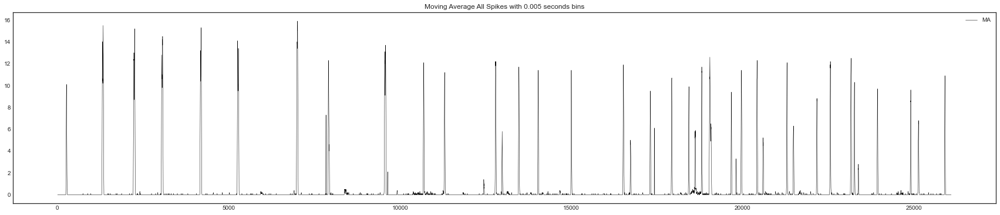

In [34]:
df= pd.DataFrame({'Spikes':full_spikes_binned}) #aus Network_ISI wird ein pdDF um die weiteren Schritte durchführen zu können
df["MA"] = df.Spikes.rolling(10).mean()
df['STD'] = df.Spikes.std()
df['2*STD'] = df.Spikes.std()*2
fig = df[['MA']].plot(color='black', linewidth=.5, figsize=(30,6), title="Moving Average All Spikes with %s seconds bins" %binsize)

#savefig('spikes_smoothed_MA.png', dpi=300)

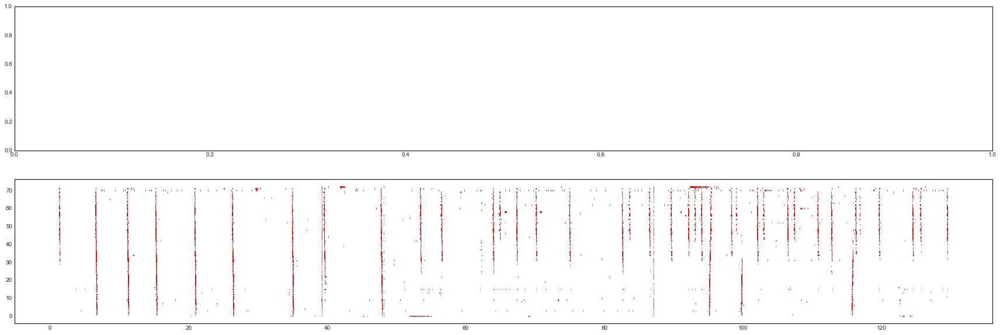

In [25]:
fig, ((ax1, ax2)) = plt.subplots(2,1, squeeze=False, figsize=(30,10))

ax2 = plt.eventplot(spikearray_seconds, linewidths=0.7, linelengths=0.5, colors='black')
ax1 = plt.eventplot(spikearray_seconds, linewidths=0.7, linelengths=0.5, colors='red')

#ax2 = df[['MA']].plot(color='b', linewidth=.5, figsize=(30,6), title="Moving Average All Spikes with %s seconds bins" %binsize)

#fig.savefig(str(filebase)+'_rasterplot.png', dpi=300)

In [239]:
filebase

'2021-05-10_cortex_div4_hCSF_ID039_nodrug_spont_1'

In [212]:
bins

array([0.00000e+00, 3.00000e-03, 6.00000e-03, ..., 1.30395e+02,
       1.30398e+02, 1.30401e+02])